# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

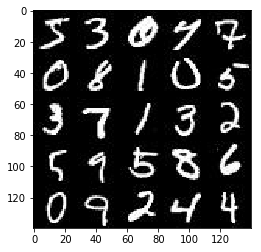

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

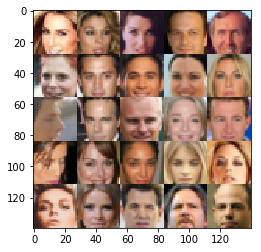

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0


/anaconda/lib/python3.6/site-packages/ipykernel/__main__.py:14: UserWarning: No GPU found. Please use a GPU to train your neural network.


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    inputs_real = tf.placeholder(tf.float32, (None, image_width, image_height, image_channels), name='inputs_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='inputs_z')
    learning_rate = tf.placeholder(tf.float32, (), name='learning_rate')
    
    return inputs_real, inputs_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [6]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """

    alpha=0.2
    x = images
    
    with tf.variable_scope('discriminator', reuse=reuse):

        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        bn1 = tf.layers.batch_normalization(x1, training=True)
        relu1 = tf.maximum(alpha * bn1, bn1)
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [17]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    reuse = not is_train
    alpha = 0.2
    
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now

        x2 = tf.layers.conv2d_transpose(x1, 256, 4, strides=1, padding='valid')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 7x7x256 now

        x3 = tf.layers.conv2d_transpose(x2, 128, 4, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # 14x14x128 now

        # Output layer
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 4, strides=2, padding='same')
        
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [18]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    smooth = 0.1
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real) * (1 - smooth)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    d_loss = d_loss_real + d_loss_fake
    
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [19]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    all_update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS)
    
    g_update_ops = [var for var in all_update_ops if var.name.startswith('generator')]
    d_update_ops = [var for var in all_update_ops if var.name.startswith('discriminator')]

    with tf.control_dependencies(d_update_ops):
        d_train_opt = tf.train.AdamOptimizer(learning_rate,beta1=beta1).minimize(d_loss, var_list=d_vars)
    with tf.control_dependencies(g_update_ops):
        g_train_opt = tf.train.AdamOptimizer(learning_rate,beta1=beta1).minimize(g_loss, var_list=g_vars)
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [20]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [45]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    
    inputs_real, inputs_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(inputs_real, inputs_z, data_shape[-1])
    d_train_opt, g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    
    steps = 0
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                steps += 1
                
                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                                
                # The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5
                #  of 28x28 dimensional images.
                batch_images = batch_images * 2
                
                # Run optimizers
                _ = sess.run(d_train_opt, feed_dict={inputs_real: batch_images, inputs_z: batch_z, lr:learning_rate})
                _ = sess.run(g_train_opt, feed_dict={inputs_z: batch_z, lr:learning_rate})
                
                
                if steps % 10 == 0:
                    # At the end of each epoch, get the losses and print them out                    
                    train_loss_d = d_loss.eval({inputs_z:batch_z, inputs_real: batch_images})
                    train_loss_g = g_loss.eval({inputs_z:batch_z})

                    print("Epoch {}/{} Step {}...".format(epoch_i+1, epoch_count, steps),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    
                    show_generator_output(sess, 25, inputs_z, data_shape[3], data_image_mode)

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2 Step 10... Discriminator Loss: 0.5029... Generator Loss: 13.6718


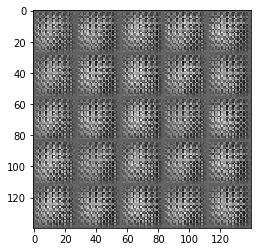

Epoch 1/2 Step 20... Discriminator Loss: 0.3973... Generator Loss: 5.9200


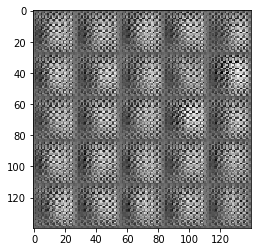

Epoch 1/2 Step 30... Discriminator Loss: 0.5920... Generator Loss: 1.7984


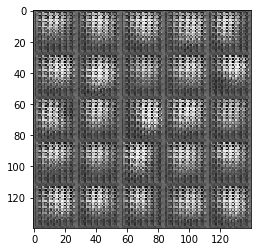

Epoch 1/2 Step 40... Discriminator Loss: 2.4719... Generator Loss: 0.8993


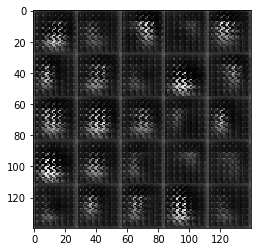

Epoch 1/2 Step 50... Discriminator Loss: 1.9581... Generator Loss: 1.2382


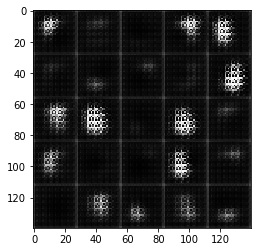

Epoch 1/2 Step 60... Discriminator Loss: 0.8175... Generator Loss: 2.3905


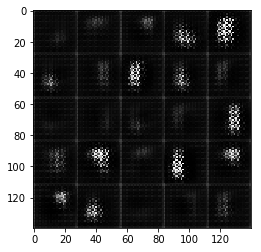

Epoch 1/2 Step 70... Discriminator Loss: 0.4747... Generator Loss: 2.8480


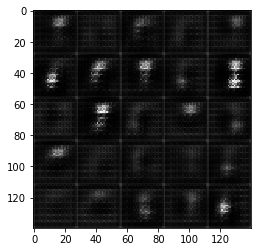

Epoch 1/2 Step 80... Discriminator Loss: 0.6375... Generator Loss: 2.5280


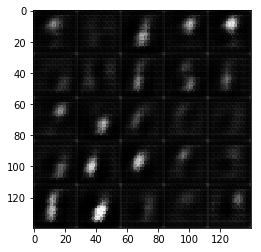

Epoch 1/2 Step 90... Discriminator Loss: 1.4505... Generator Loss: 0.7230


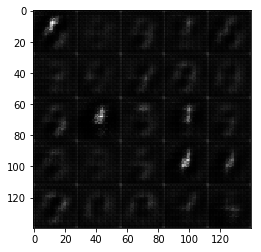

Epoch 1/2 Step 100... Discriminator Loss: 0.8829... Generator Loss: 1.4267


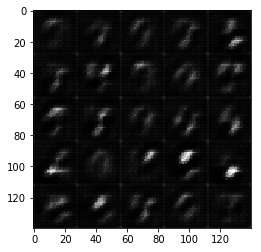

Epoch 1/2 Step 110... Discriminator Loss: 1.7353... Generator Loss: 0.4469


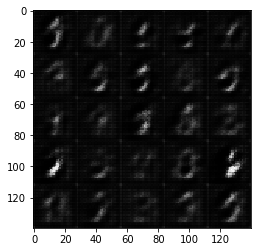

Epoch 1/2 Step 120... Discriminator Loss: 0.8397... Generator Loss: 2.5694


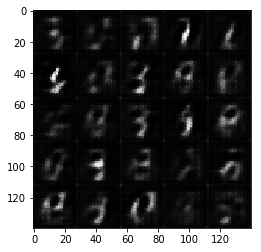

Epoch 1/2 Step 130... Discriminator Loss: 0.9618... Generator Loss: 1.3167


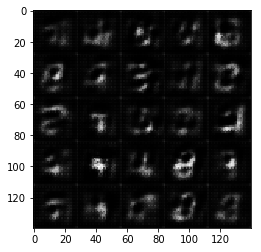

Epoch 1/2 Step 140... Discriminator Loss: 0.9219... Generator Loss: 1.9338


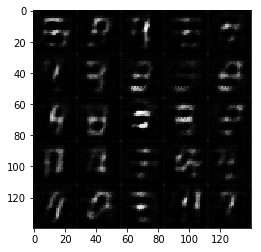

Epoch 1/2 Step 150... Discriminator Loss: 1.0883... Generator Loss: 1.5879


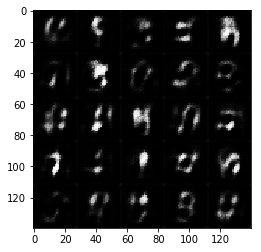

Epoch 1/2 Step 160... Discriminator Loss: 0.7028... Generator Loss: 2.3294


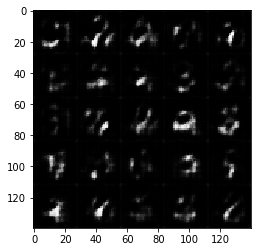

Epoch 1/2 Step 170... Discriminator Loss: 0.9315... Generator Loss: 1.2033


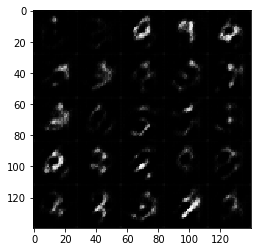

Epoch 1/2 Step 180... Discriminator Loss: 0.9793... Generator Loss: 1.6658


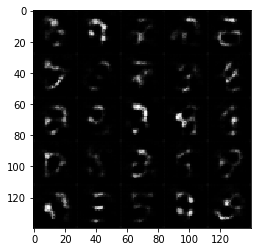

Epoch 1/2 Step 190... Discriminator Loss: 0.9317... Generator Loss: 1.7269


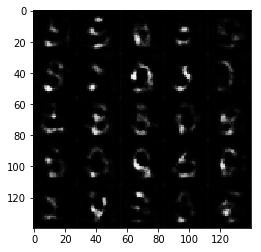

Epoch 1/2 Step 200... Discriminator Loss: 0.8364... Generator Loss: 1.3814


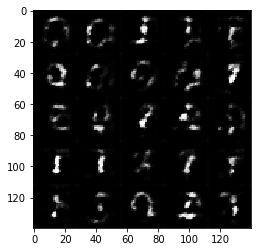

Epoch 1/2 Step 210... Discriminator Loss: 1.0986... Generator Loss: 1.4712


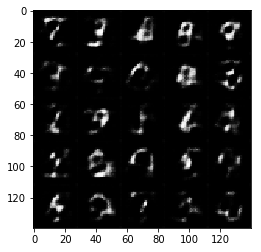

Epoch 1/2 Step 220... Discriminator Loss: 1.1386... Generator Loss: 1.7293


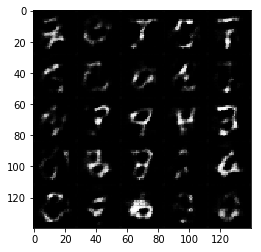

Epoch 1/2 Step 230... Discriminator Loss: 1.6057... Generator Loss: 0.5020


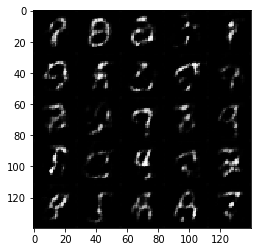

Epoch 1/2 Step 240... Discriminator Loss: 0.9902... Generator Loss: 1.3689


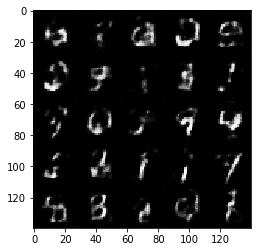

Epoch 1/2 Step 250... Discriminator Loss: 0.9861... Generator Loss: 1.7618


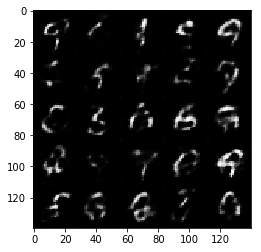

Epoch 1/2 Step 260... Discriminator Loss: 1.0221... Generator Loss: 1.2660


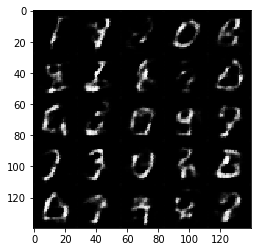

Epoch 1/2 Step 270... Discriminator Loss: 1.1284... Generator Loss: 0.8141


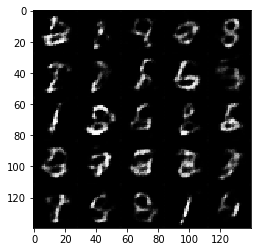

Epoch 1/2 Step 280... Discriminator Loss: 0.9673... Generator Loss: 1.6190


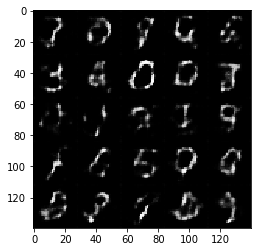

Epoch 1/2 Step 290... Discriminator Loss: 0.9445... Generator Loss: 1.1910


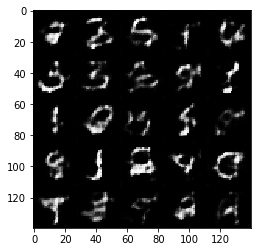

Epoch 1/2 Step 300... Discriminator Loss: 1.2023... Generator Loss: 1.0230


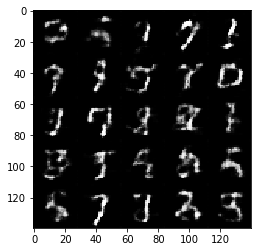

Epoch 1/2 Step 310... Discriminator Loss: 1.0813... Generator Loss: 1.8403


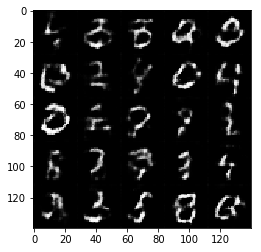

Epoch 1/2 Step 320... Discriminator Loss: 0.9771... Generator Loss: 1.1731


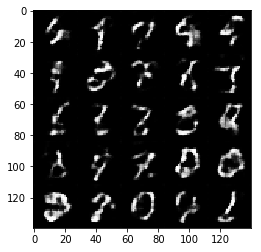

Epoch 1/2 Step 330... Discriminator Loss: 1.3251... Generator Loss: 0.6853


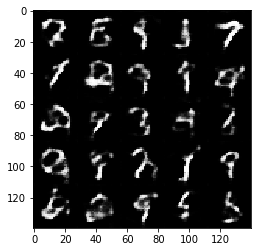

Epoch 1/2 Step 340... Discriminator Loss: 1.3396... Generator Loss: 1.9380


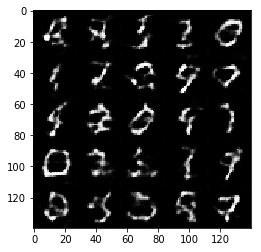

Epoch 1/2 Step 350... Discriminator Loss: 0.9792... Generator Loss: 1.0845


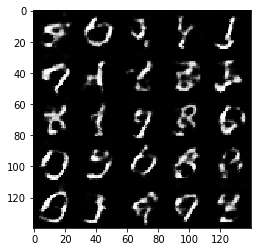

Epoch 1/2 Step 360... Discriminator Loss: 1.1339... Generator Loss: 1.4109


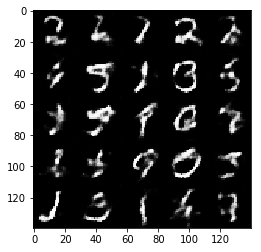

Epoch 1/2 Step 370... Discriminator Loss: 0.9979... Generator Loss: 1.6021


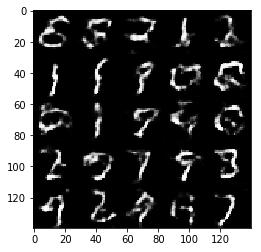

Epoch 1/2 Step 380... Discriminator Loss: 0.8663... Generator Loss: 1.5250


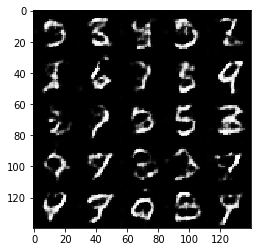

Epoch 1/2 Step 390... Discriminator Loss: 1.2672... Generator Loss: 0.7346


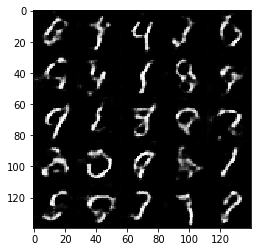

Epoch 1/2 Step 400... Discriminator Loss: 1.2299... Generator Loss: 0.7660


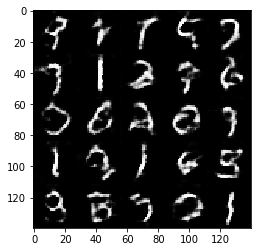

Epoch 1/2 Step 410... Discriminator Loss: 1.1422... Generator Loss: 1.5220


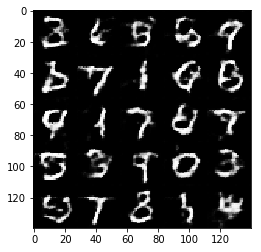

Epoch 1/2 Step 420... Discriminator Loss: 1.0799... Generator Loss: 2.3103


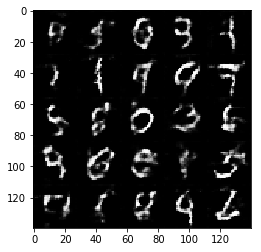

Epoch 1/2 Step 430... Discriminator Loss: 1.0819... Generator Loss: 0.9732


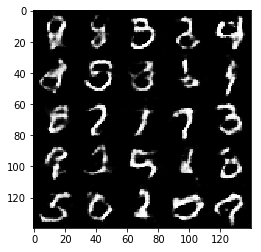

Epoch 1/2 Step 440... Discriminator Loss: 1.0948... Generator Loss: 1.0049


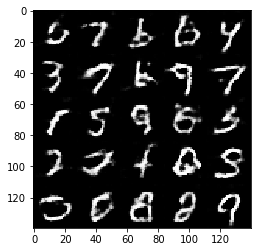

Epoch 1/2 Step 450... Discriminator Loss: 1.2269... Generator Loss: 1.4512


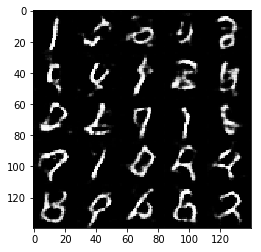

Epoch 1/2 Step 460... Discriminator Loss: 1.2752... Generator Loss: 0.6444


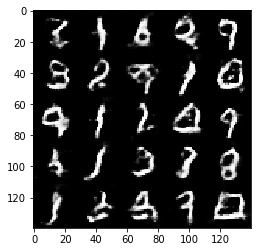

Epoch 1/2 Step 470... Discriminator Loss: 1.1465... Generator Loss: 0.7171


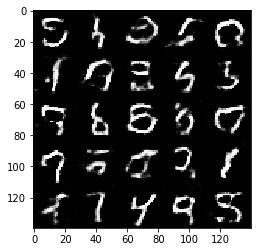

Epoch 1/2 Step 480... Discriminator Loss: 1.0921... Generator Loss: 2.1928


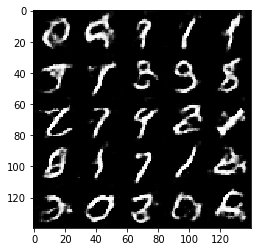

Epoch 1/2 Step 490... Discriminator Loss: 0.9817... Generator Loss: 1.1282


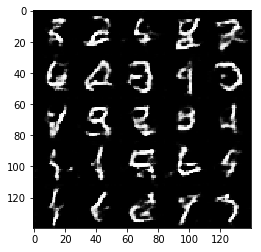

Epoch 1/2 Step 500... Discriminator Loss: 1.4311... Generator Loss: 0.5270


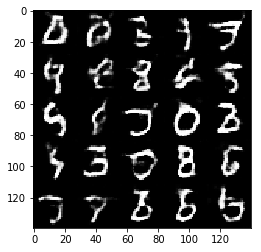

Epoch 1/2 Step 510... Discriminator Loss: 1.8634... Generator Loss: 3.0513


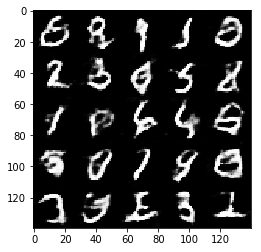

Epoch 1/2 Step 520... Discriminator Loss: 1.0245... Generator Loss: 0.9661


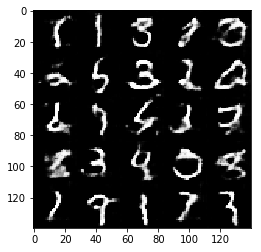

Epoch 1/2 Step 530... Discriminator Loss: 1.1026... Generator Loss: 0.7821


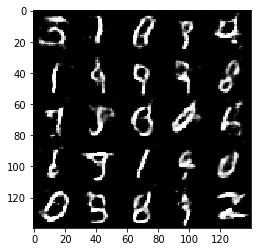

Epoch 1/2 Step 540... Discriminator Loss: 1.1663... Generator Loss: 2.1899


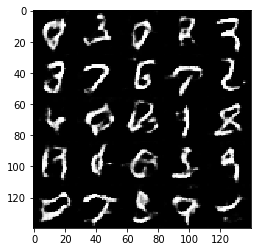

Epoch 1/2 Step 550... Discriminator Loss: 0.9132... Generator Loss: 1.2958


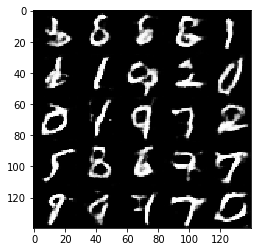

Epoch 1/2 Step 560... Discriminator Loss: 1.5713... Generator Loss: 2.3580


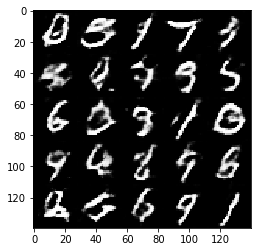

Epoch 1/2 Step 570... Discriminator Loss: 1.2366... Generator Loss: 1.1321


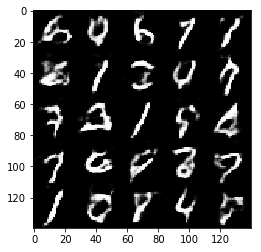

Epoch 1/2 Step 580... Discriminator Loss: 0.9463... Generator Loss: 1.2441


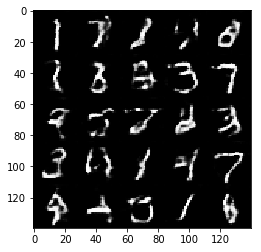

Epoch 1/2 Step 590... Discriminator Loss: 1.8268... Generator Loss: 2.5299


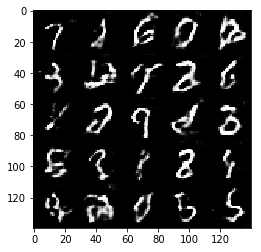

Epoch 1/2 Step 600... Discriminator Loss: 0.9875... Generator Loss: 1.1532


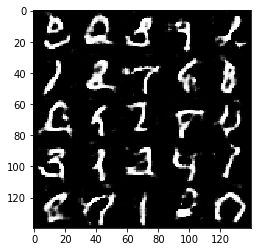

Epoch 2/2 Step 610... Discriminator Loss: 1.1414... Generator Loss: 1.0308


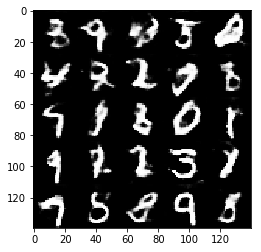

Epoch 2/2 Step 620... Discriminator Loss: 1.1135... Generator Loss: 1.3415


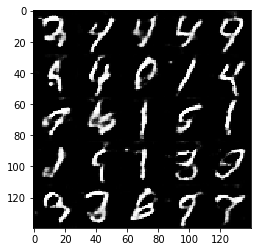

Epoch 2/2 Step 630... Discriminator Loss: 1.0629... Generator Loss: 0.7965


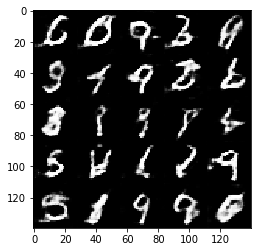

Epoch 2/2 Step 640... Discriminator Loss: 1.3967... Generator Loss: 2.4287


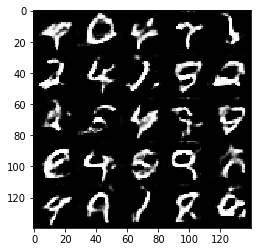

Epoch 2/2 Step 650... Discriminator Loss: 1.0435... Generator Loss: 1.0152


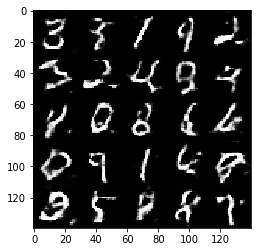

Epoch 2/2 Step 660... Discriminator Loss: 1.0506... Generator Loss: 1.0989


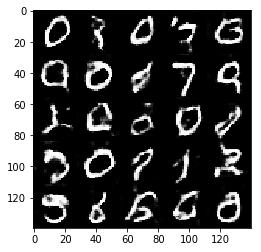

Epoch 2/2 Step 670... Discriminator Loss: 1.1918... Generator Loss: 1.7962


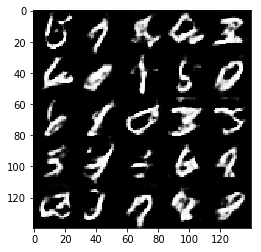

Epoch 2/2 Step 680... Discriminator Loss: 0.9899... Generator Loss: 0.9200


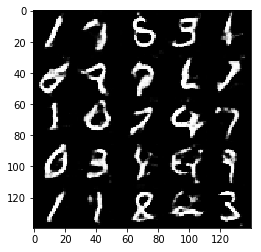

Epoch 2/2 Step 690... Discriminator Loss: 0.9020... Generator Loss: 1.5624


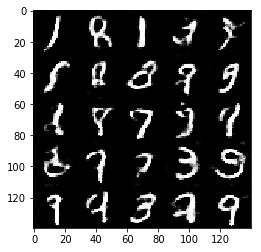

Epoch 2/2 Step 700... Discriminator Loss: 1.0518... Generator Loss: 1.0864


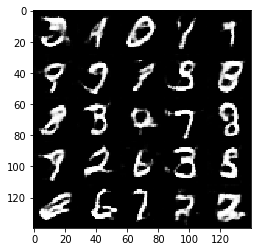

Epoch 2/2 Step 710... Discriminator Loss: 0.9420... Generator Loss: 1.3373


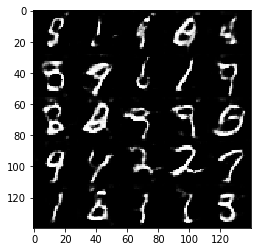

Epoch 2/2 Step 720... Discriminator Loss: 1.2422... Generator Loss: 1.8534


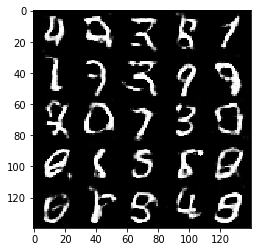

Epoch 2/2 Step 730... Discriminator Loss: 1.0676... Generator Loss: 0.9498


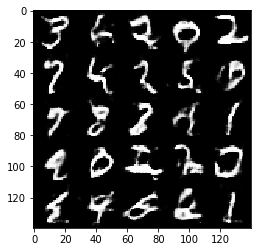

Epoch 2/2 Step 740... Discriminator Loss: 1.1642... Generator Loss: 1.0696


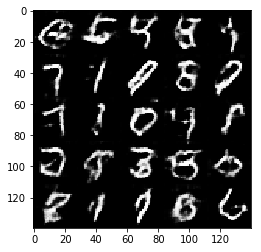

Epoch 2/2 Step 750... Discriminator Loss: 0.9153... Generator Loss: 1.1272


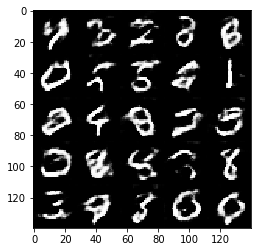

Epoch 2/2 Step 760... Discriminator Loss: 0.7707... Generator Loss: 1.5184


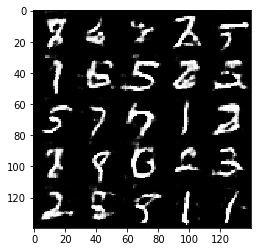

Epoch 2/2 Step 770... Discriminator Loss: 1.2855... Generator Loss: 1.2936


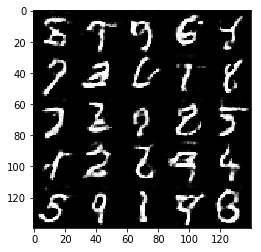

Epoch 2/2 Step 780... Discriminator Loss: 1.3050... Generator Loss: 1.6306


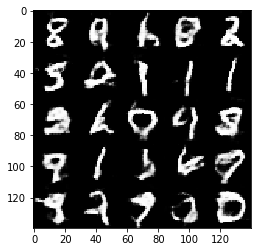

Epoch 2/2 Step 790... Discriminator Loss: 1.0949... Generator Loss: 0.9207


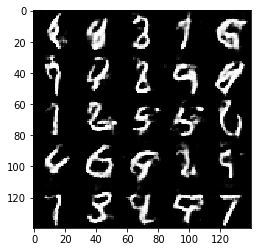

Epoch 2/2 Step 800... Discriminator Loss: 1.5033... Generator Loss: 0.4991


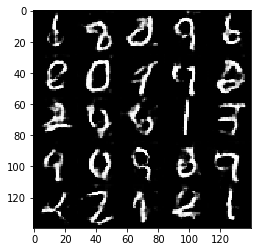

Epoch 2/2 Step 810... Discriminator Loss: 0.8424... Generator Loss: 1.2358


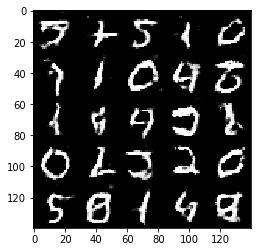

Epoch 2/2 Step 820... Discriminator Loss: 0.9984... Generator Loss: 0.9049


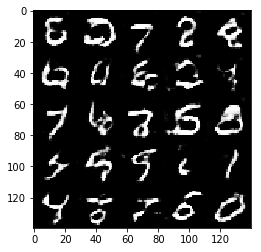

Epoch 2/2 Step 830... Discriminator Loss: 2.2901... Generator Loss: 3.9800


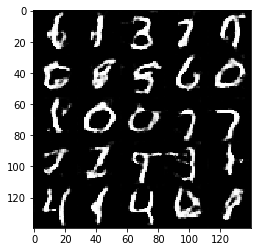

Epoch 2/2 Step 840... Discriminator Loss: 0.9888... Generator Loss: 0.8996


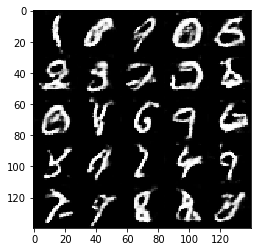

Epoch 2/2 Step 850... Discriminator Loss: 0.9381... Generator Loss: 1.7068


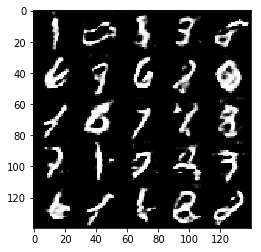

Epoch 2/2 Step 860... Discriminator Loss: 0.9388... Generator Loss: 1.0107


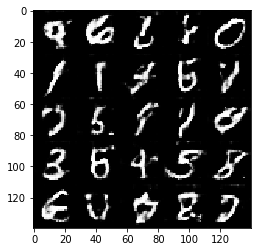

Epoch 2/2 Step 870... Discriminator Loss: 1.3905... Generator Loss: 2.5204


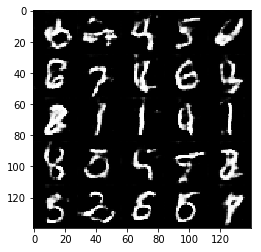

Epoch 2/2 Step 880... Discriminator Loss: 0.8387... Generator Loss: 1.2119


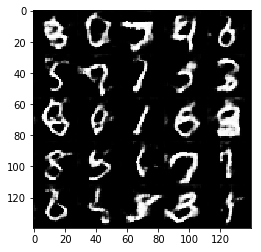

Epoch 2/2 Step 890... Discriminator Loss: 1.0102... Generator Loss: 0.9373


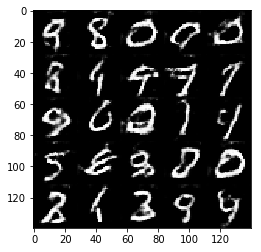

Epoch 2/2 Step 900... Discriminator Loss: 1.0846... Generator Loss: 0.9144


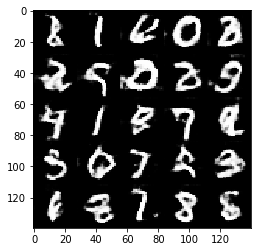

Epoch 2/2 Step 910... Discriminator Loss: 0.8437... Generator Loss: 1.7718


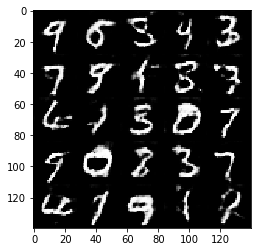

Epoch 2/2 Step 920... Discriminator Loss: 1.3475... Generator Loss: 0.5233


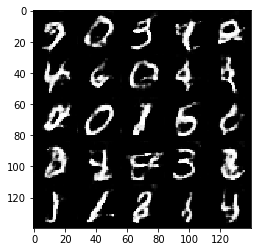

Epoch 2/2 Step 930... Discriminator Loss: 0.9462... Generator Loss: 0.9331


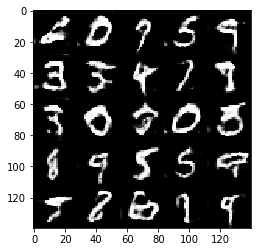

Epoch 2/2 Step 940... Discriminator Loss: 1.5732... Generator Loss: 2.9082


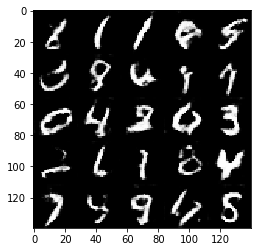

Epoch 2/2 Step 950... Discriminator Loss: 0.8093... Generator Loss: 1.3067


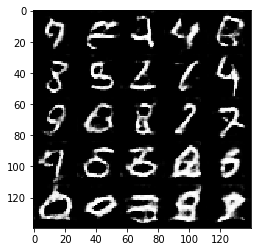

Epoch 2/2 Step 960... Discriminator Loss: 0.9897... Generator Loss: 0.9121


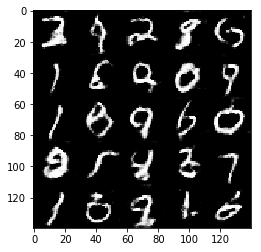

Epoch 2/2 Step 970... Discriminator Loss: 1.0493... Generator Loss: 0.8296


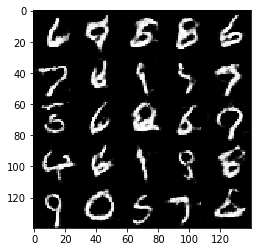

Epoch 2/2 Step 980... Discriminator Loss: 0.8968... Generator Loss: 2.3771


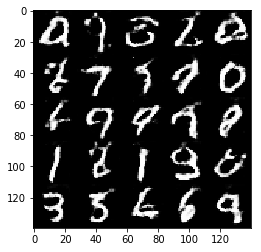

Epoch 2/2 Step 990... Discriminator Loss: 0.9293... Generator Loss: 1.0723


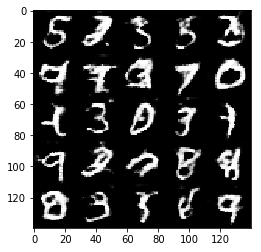

Epoch 2/2 Step 1000... Discriminator Loss: 0.9841... Generator Loss: 0.9051


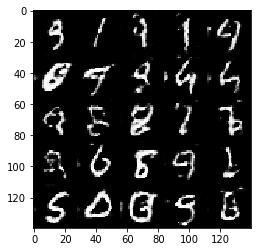

Epoch 2/2 Step 1010... Discriminator Loss: 0.7083... Generator Loss: 1.3982


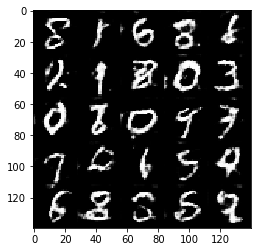

Epoch 2/2 Step 1020... Discriminator Loss: 0.9425... Generator Loss: 1.1928


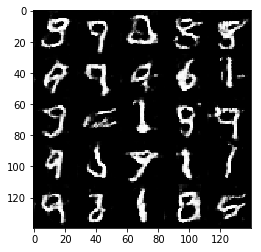

Epoch 2/2 Step 1030... Discriminator Loss: 1.0746... Generator Loss: 0.8555


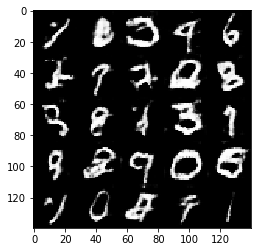

Epoch 2/2 Step 1040... Discriminator Loss: 0.7718... Generator Loss: 1.6931


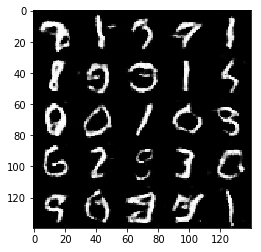

Epoch 2/2 Step 1050... Discriminator Loss: 0.7369... Generator Loss: 1.4300


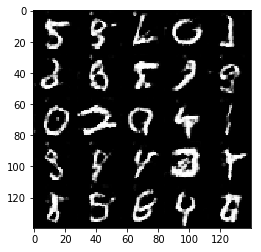

Epoch 2/2 Step 1060... Discriminator Loss: 1.0232... Generator Loss: 1.4694


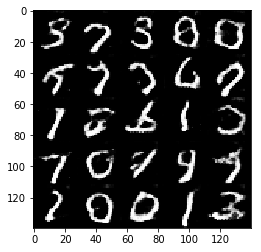

Epoch 2/2 Step 1070... Discriminator Loss: 0.9011... Generator Loss: 1.1697


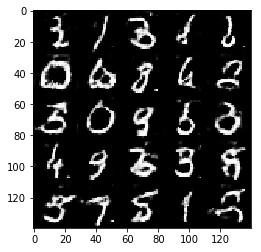

Epoch 2/2 Step 1080... Discriminator Loss: 0.8162... Generator Loss: 1.5539


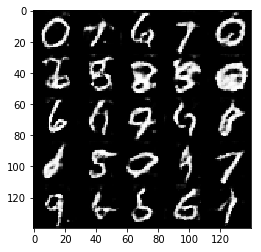

Epoch 2/2 Step 1090... Discriminator Loss: 0.7879... Generator Loss: 1.2277


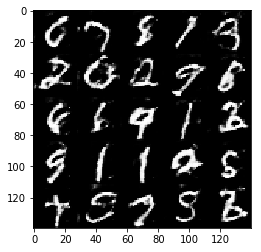

Epoch 2/2 Step 1100... Discriminator Loss: 2.6459... Generator Loss: 0.2164


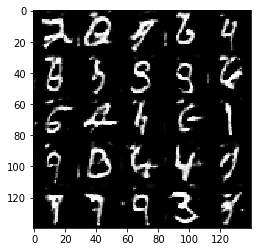

Epoch 2/2 Step 1110... Discriminator Loss: 0.7888... Generator Loss: 1.3165


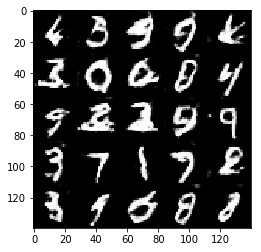

Epoch 2/2 Step 1120... Discriminator Loss: 0.8585... Generator Loss: 1.7816


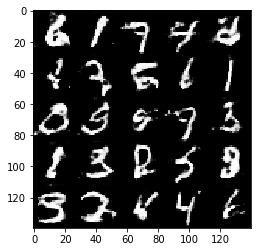

Epoch 2/2 Step 1130... Discriminator Loss: 0.8062... Generator Loss: 1.1912


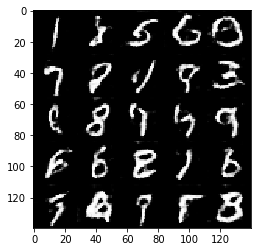

Epoch 2/2 Step 1140... Discriminator Loss: 1.2256... Generator Loss: 0.8366


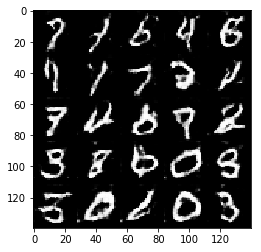

Epoch 2/2 Step 1150... Discriminator Loss: 2.6555... Generator Loss: 5.7804


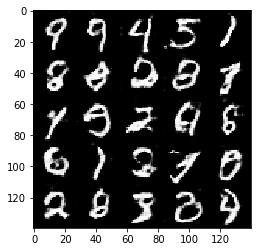

Epoch 2/2 Step 1160... Discriminator Loss: 1.2322... Generator Loss: 2.2005


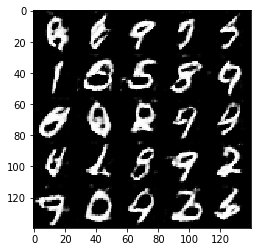

Epoch 2/2 Step 1170... Discriminator Loss: 0.8961... Generator Loss: 1.8141


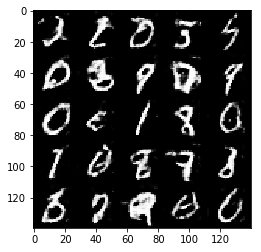

Epoch 2/2 Step 1180... Discriminator Loss: 0.7280... Generator Loss: 1.3530


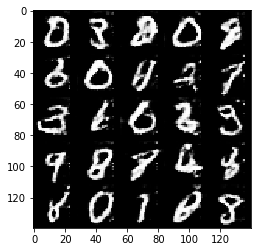

Epoch 2/2 Step 1190... Discriminator Loss: 1.0342... Generator Loss: 0.8049


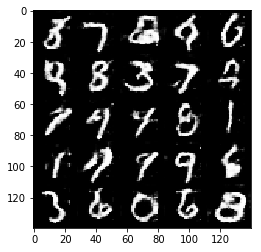

Epoch 2/2 Step 1200... Discriminator Loss: 0.6877... Generator Loss: 1.5958


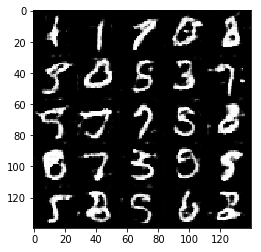

In [47]:
batch_size = 100
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1 Step 10... Discriminator Loss: 1.0662... Generator Loss: 0.9333


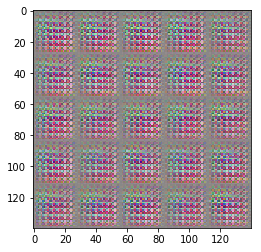

Epoch 1/1 Step 20... Discriminator Loss: 0.4710... Generator Loss: 8.0722


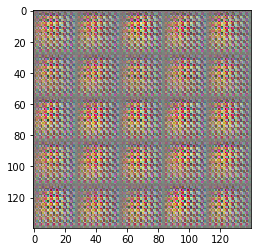

Epoch 1/1 Step 30... Discriminator Loss: 1.2519... Generator Loss: 0.5990


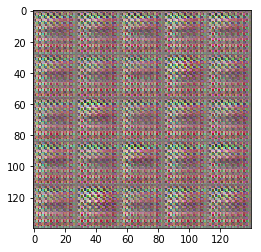

Epoch 1/1 Step 40... Discriminator Loss: 0.5316... Generator Loss: 6.8169


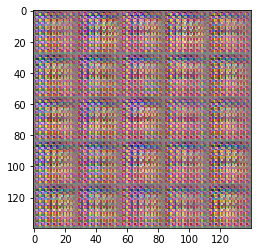

Epoch 1/1 Step 50... Discriminator Loss: 0.4841... Generator Loss: 9.6191


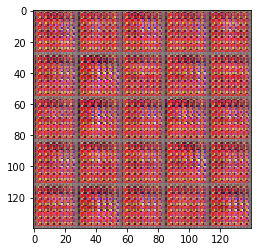

Epoch 1/1 Step 60... Discriminator Loss: 0.4989... Generator Loss: 5.8106


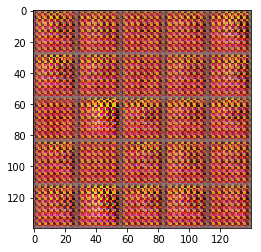

Epoch 1/1 Step 70... Discriminator Loss: 0.8144... Generator Loss: 1.4364


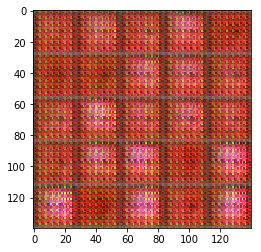

Epoch 1/1 Step 80... Discriminator Loss: 0.6517... Generator Loss: 2.1403


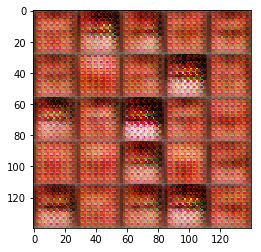

Epoch 1/1 Step 90... Discriminator Loss: 1.0426... Generator Loss: 1.2611


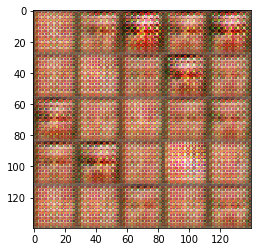

Epoch 1/1 Step 100... Discriminator Loss: 0.8652... Generator Loss: 6.5052


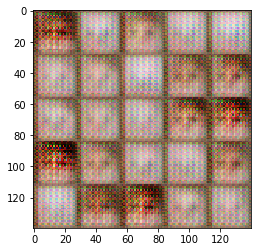

Epoch 1/1 Step 110... Discriminator Loss: 1.8030... Generator Loss: 6.4883


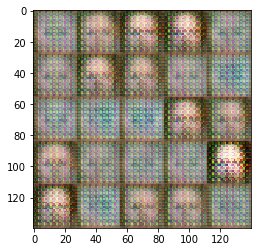

Epoch 1/1 Step 120... Discriminator Loss: 0.8502... Generator Loss: 1.2984


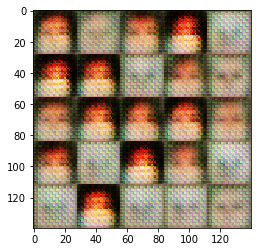

Epoch 1/1 Step 130... Discriminator Loss: 0.8158... Generator Loss: 1.5028


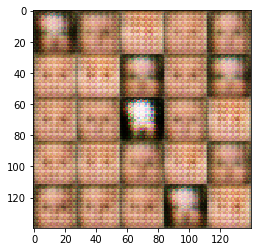

Epoch 1/1 Step 140... Discriminator Loss: 0.6846... Generator Loss: 2.1801


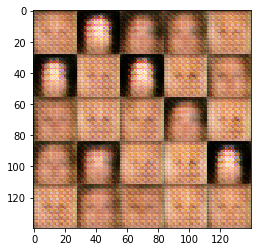

Epoch 1/1 Step 150... Discriminator Loss: 1.6317... Generator Loss: 1.6608


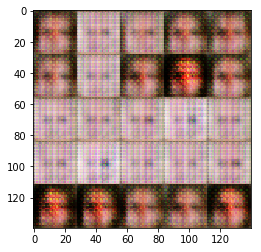

Epoch 1/1 Step 160... Discriminator Loss: 1.1195... Generator Loss: 0.9082


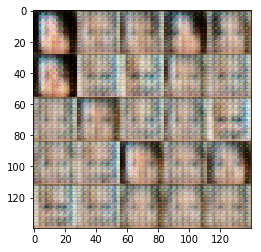

Epoch 1/1 Step 170... Discriminator Loss: 0.9379... Generator Loss: 0.9944


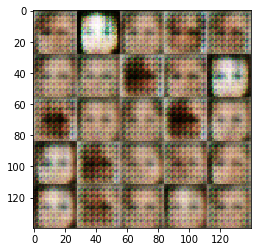

Epoch 1/1 Step 180... Discriminator Loss: 1.5938... Generator Loss: 0.6079


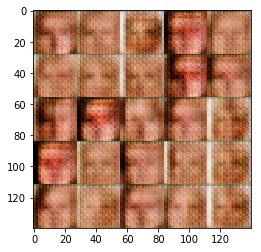

Epoch 1/1 Step 190... Discriminator Loss: 1.3783... Generator Loss: 0.7598


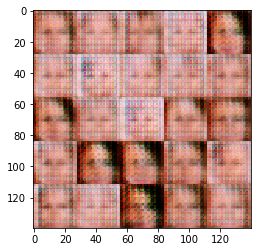

Epoch 1/1 Step 200... Discriminator Loss: 0.8252... Generator Loss: 2.1521


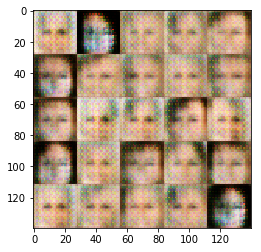

Epoch 1/1 Step 210... Discriminator Loss: 1.4325... Generator Loss: 0.5273


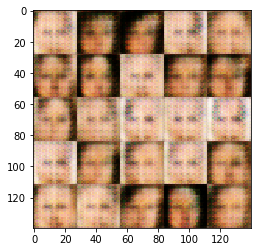

Epoch 1/1 Step 220... Discriminator Loss: 1.7940... Generator Loss: 3.1527


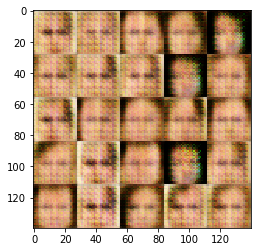

Epoch 1/1 Step 230... Discriminator Loss: 1.1512... Generator Loss: 0.7887


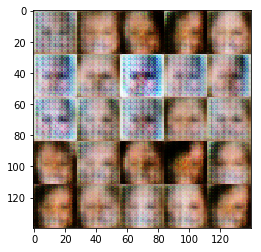

Epoch 1/1 Step 240... Discriminator Loss: 1.3756... Generator Loss: 1.1264


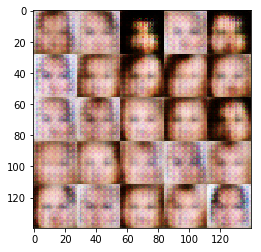

Epoch 1/1 Step 250... Discriminator Loss: 1.3623... Generator Loss: 0.6425


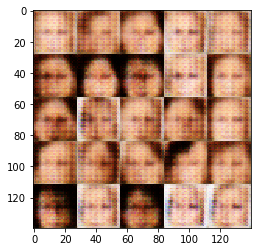

Epoch 1/1 Step 260... Discriminator Loss: 1.1005... Generator Loss: 0.8126


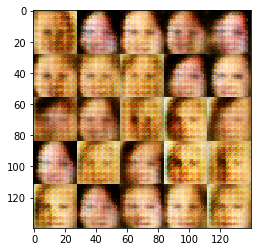

Epoch 1/1 Step 270... Discriminator Loss: 1.5906... Generator Loss: 0.4366


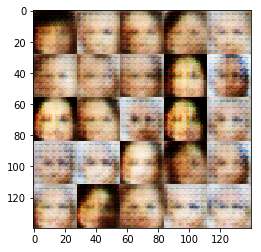

Epoch 1/1 Step 280... Discriminator Loss: 1.0297... Generator Loss: 1.6200


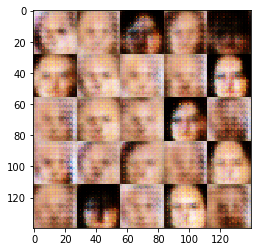

Epoch 1/1 Step 290... Discriminator Loss: 1.1409... Generator Loss: 0.8372


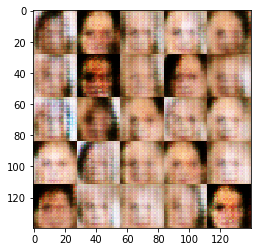

Epoch 1/1 Step 300... Discriminator Loss: 1.0693... Generator Loss: 1.8248


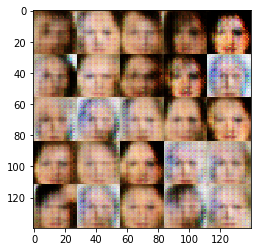

Epoch 1/1 Step 310... Discriminator Loss: 0.6934... Generator Loss: 1.5171


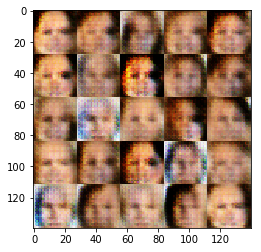

Epoch 1/1 Step 320... Discriminator Loss: 1.1087... Generator Loss: 1.5110


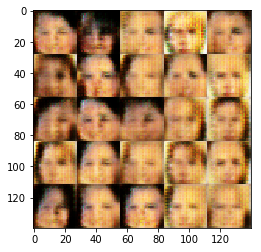

Epoch 1/1 Step 330... Discriminator Loss: 1.3329... Generator Loss: 0.5326


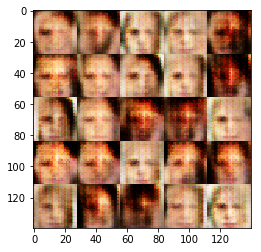

Epoch 1/1 Step 340... Discriminator Loss: 1.4590... Generator Loss: 0.4990


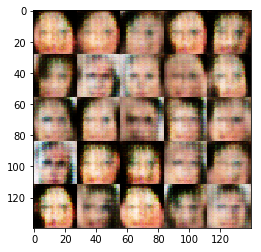

Epoch 1/1 Step 350... Discriminator Loss: 1.1758... Generator Loss: 0.7552


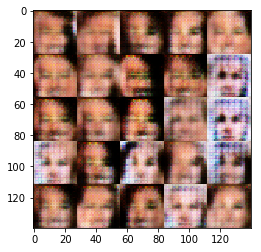

Epoch 1/1 Step 360... Discriminator Loss: 0.8156... Generator Loss: 1.1982


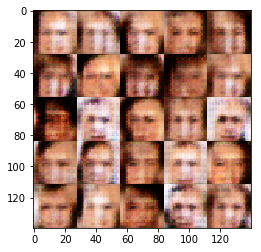

Epoch 1/1 Step 370... Discriminator Loss: 1.1987... Generator Loss: 0.7246


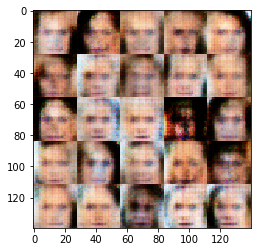

Epoch 1/1 Step 380... Discriminator Loss: 0.6832... Generator Loss: 2.1742


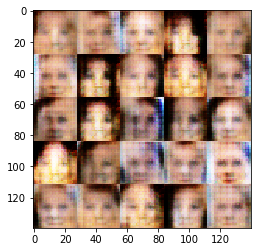

Epoch 1/1 Step 390... Discriminator Loss: 1.6431... Generator Loss: 3.3756


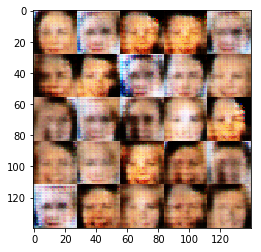

Epoch 1/1 Step 400... Discriminator Loss: 0.8967... Generator Loss: 2.3631


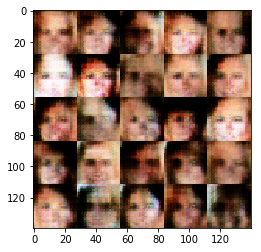

Epoch 1/1 Step 410... Discriminator Loss: 0.7733... Generator Loss: 1.7964


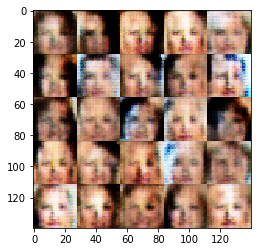

Epoch 1/1 Step 420... Discriminator Loss: 0.9838... Generator Loss: 0.9600


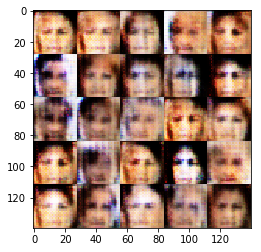

Epoch 1/1 Step 430... Discriminator Loss: 0.7496... Generator Loss: 1.4385


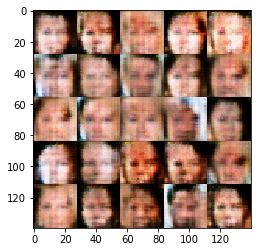

Epoch 1/1 Step 440... Discriminator Loss: 1.1735... Generator Loss: 0.7710


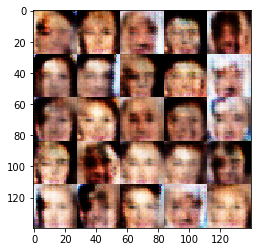

Epoch 1/1 Step 450... Discriminator Loss: 1.1391... Generator Loss: 2.9369


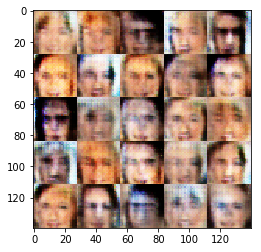

Epoch 1/1 Step 460... Discriminator Loss: 1.1900... Generator Loss: 0.7251


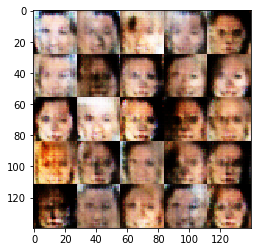

Epoch 1/1 Step 470... Discriminator Loss: 0.8822... Generator Loss: 1.4142


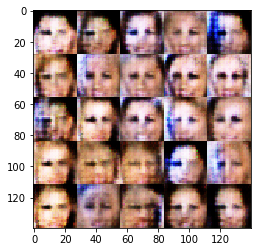

Epoch 1/1 Step 480... Discriminator Loss: 1.1693... Generator Loss: 1.8320


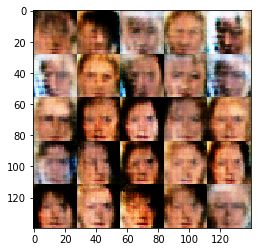

Epoch 1/1 Step 490... Discriminator Loss: 1.4422... Generator Loss: 0.5776


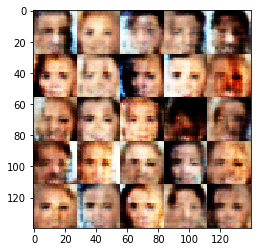

Epoch 1/1 Step 500... Discriminator Loss: 1.1166... Generator Loss: 1.4179


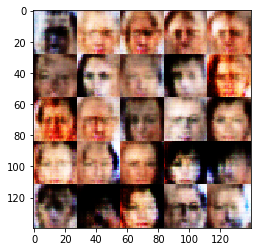

Epoch 1/1 Step 510... Discriminator Loss: 1.4795... Generator Loss: 0.5241


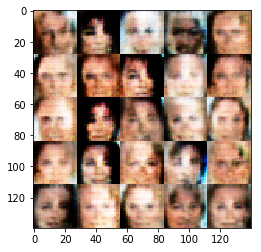

Epoch 1/1 Step 520... Discriminator Loss: 1.1272... Generator Loss: 0.7478


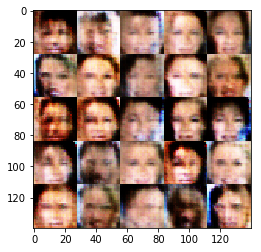

Epoch 1/1 Step 530... Discriminator Loss: 0.6836... Generator Loss: 2.0313


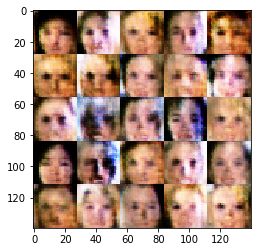

Epoch 1/1 Step 540... Discriminator Loss: 1.1549... Generator Loss: 1.2163


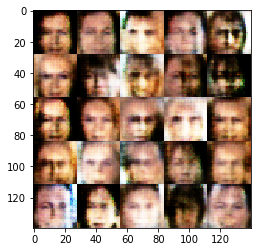

Epoch 1/1 Step 550... Discriminator Loss: 1.1929... Generator Loss: 1.1154


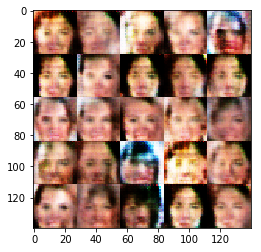

Epoch 1/1 Step 560... Discriminator Loss: 1.3473... Generator Loss: 1.3986


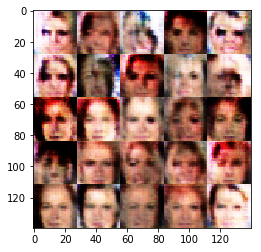

Epoch 1/1 Step 570... Discriminator Loss: 1.2443... Generator Loss: 0.6722


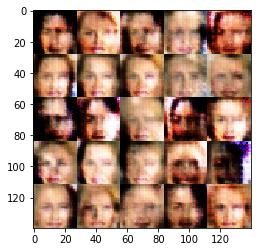

Epoch 1/1 Step 580... Discriminator Loss: 1.0852... Generator Loss: 0.7773


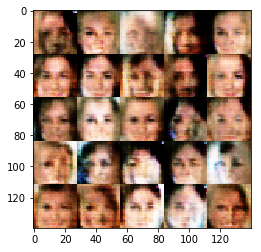

Epoch 1/1 Step 590... Discriminator Loss: 0.7764... Generator Loss: 1.4918


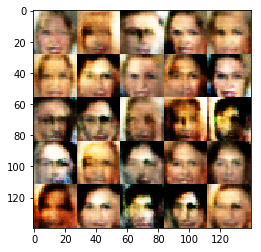

Epoch 1/1 Step 600... Discriminator Loss: 1.0070... Generator Loss: 1.2919


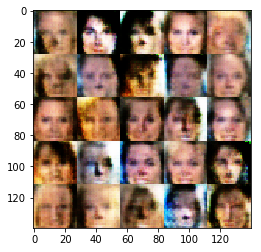

Epoch 1/1 Step 610... Discriminator Loss: 1.5802... Generator Loss: 2.8311


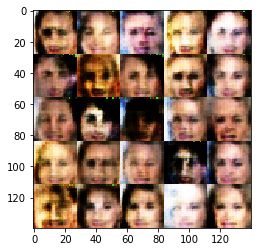

Epoch 1/1 Step 620... Discriminator Loss: 1.6063... Generator Loss: 0.3928


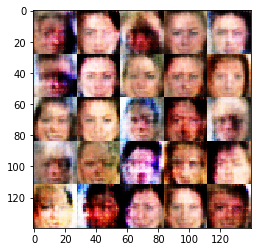

Epoch 1/1 Step 630... Discriminator Loss: 1.4186... Generator Loss: 0.5223


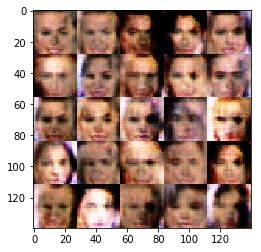

Epoch 1/1 Step 640... Discriminator Loss: 1.0461... Generator Loss: 1.9804


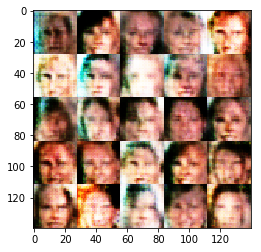

Epoch 1/1 Step 650... Discriminator Loss: 1.8014... Generator Loss: 2.9036


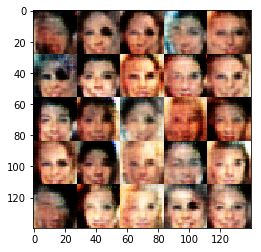

Epoch 1/1 Step 660... Discriminator Loss: 1.1472... Generator Loss: 0.9507


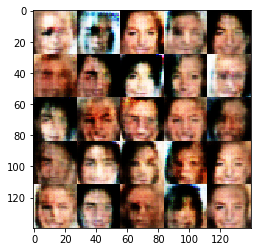

Epoch 1/1 Step 670... Discriminator Loss: 1.0795... Generator Loss: 1.5330


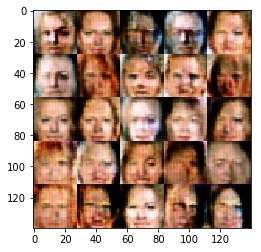

Epoch 1/1 Step 680... Discriminator Loss: 0.9180... Generator Loss: 2.7315


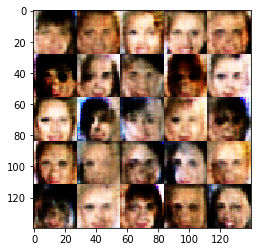

Epoch 1/1 Step 690... Discriminator Loss: 0.8875... Generator Loss: 1.0820


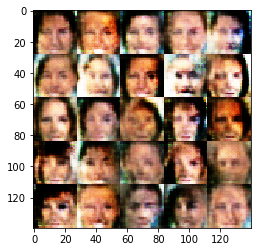

Epoch 1/1 Step 700... Discriminator Loss: 1.2643... Generator Loss: 0.6449


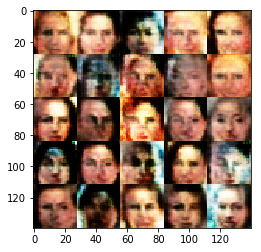

Epoch 1/1 Step 710... Discriminator Loss: 0.9654... Generator Loss: 1.5018


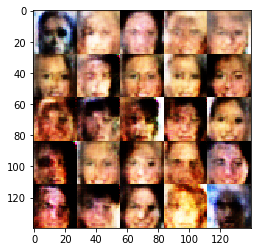

Epoch 1/1 Step 720... Discriminator Loss: 0.9354... Generator Loss: 1.0759


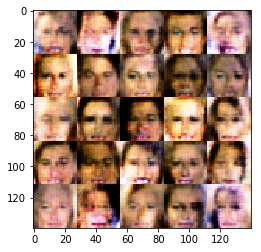

Epoch 1/1 Step 730... Discriminator Loss: 1.3564... Generator Loss: 0.5769


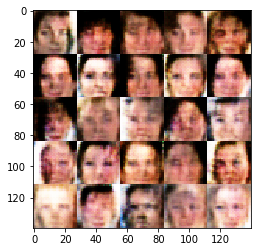

Epoch 1/1 Step 740... Discriminator Loss: 0.7153... Generator Loss: 2.0666


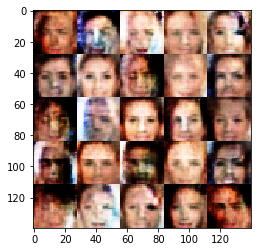

Epoch 1/1 Step 750... Discriminator Loss: 0.8691... Generator Loss: 1.0953


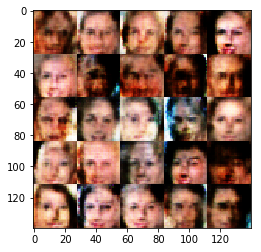

Epoch 1/1 Step 760... Discriminator Loss: 1.2673... Generator Loss: 2.7935


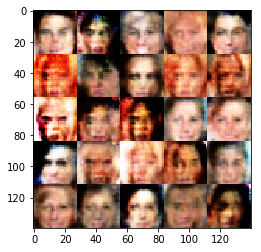

Epoch 1/1 Step 770... Discriminator Loss: 0.9401... Generator Loss: 1.2765


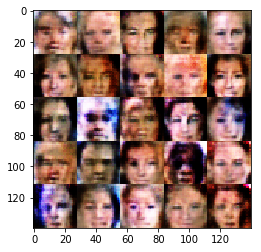

Epoch 1/1 Step 780... Discriminator Loss: 0.8334... Generator Loss: 1.5569


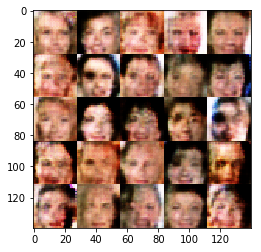

Epoch 1/1 Step 790... Discriminator Loss: 1.0103... Generator Loss: 0.9642


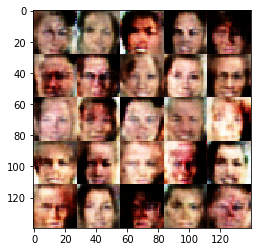

Epoch 1/1 Step 800... Discriminator Loss: 0.8742... Generator Loss: 2.3721


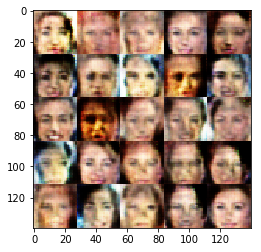

Epoch 1/1 Step 810... Discriminator Loss: 0.9334... Generator Loss: 1.1510


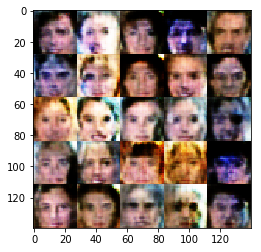

Epoch 1/1 Step 820... Discriminator Loss: 1.5314... Generator Loss: 3.0153


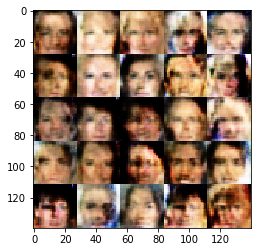

Epoch 1/1 Step 830... Discriminator Loss: 1.9747... Generator Loss: 4.1049


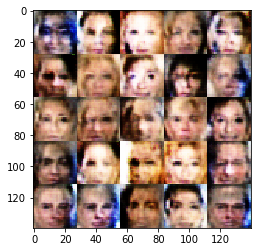

Epoch 1/1 Step 840... Discriminator Loss: 0.8551... Generator Loss: 1.1490


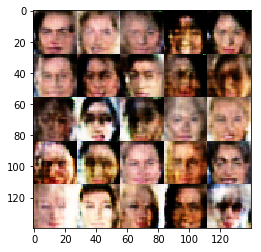

Epoch 1/1 Step 850... Discriminator Loss: 0.7759... Generator Loss: 1.4773


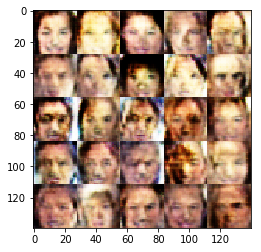

Epoch 1/1 Step 860... Discriminator Loss: 0.9907... Generator Loss: 2.3366


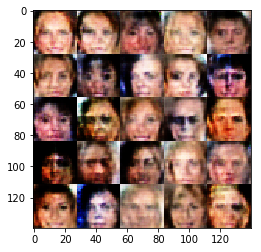

Epoch 1/1 Step 870... Discriminator Loss: 1.4034... Generator Loss: 0.5601


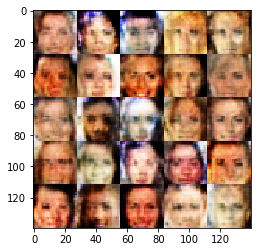

Epoch 1/1 Step 880... Discriminator Loss: 1.2777... Generator Loss: 0.6734


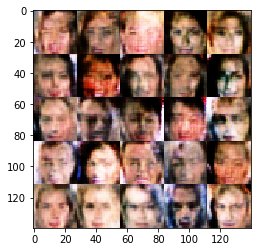

Epoch 1/1 Step 890... Discriminator Loss: 1.1092... Generator Loss: 1.2947


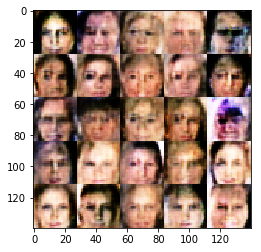

Epoch 1/1 Step 900... Discriminator Loss: 1.1198... Generator Loss: 0.7691


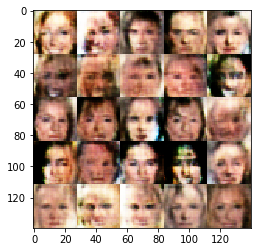

Epoch 1/1 Step 910... Discriminator Loss: 1.3848... Generator Loss: 0.5594


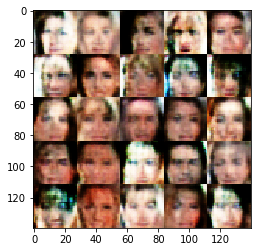

Epoch 1/1 Step 920... Discriminator Loss: 1.3874... Generator Loss: 2.5465


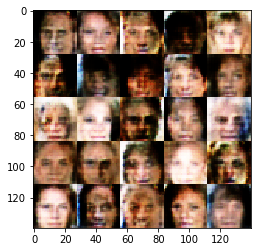

Epoch 1/1 Step 930... Discriminator Loss: 1.0317... Generator Loss: 1.7669


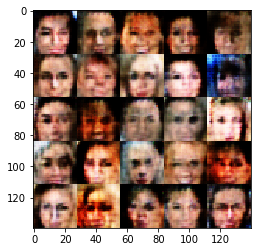

Epoch 1/1 Step 940... Discriminator Loss: 0.9671... Generator Loss: 2.3662


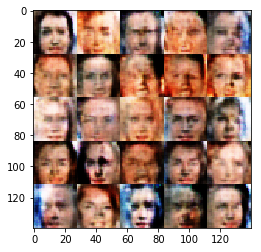

Epoch 1/1 Step 950... Discriminator Loss: 0.7987... Generator Loss: 1.4621


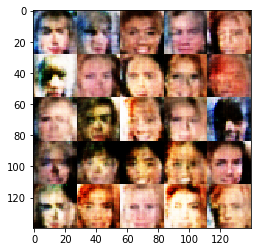

Epoch 1/1 Step 960... Discriminator Loss: 1.2279... Generator Loss: 0.6691


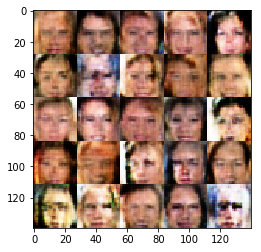

Epoch 1/1 Step 970... Discriminator Loss: 1.7732... Generator Loss: 2.3674


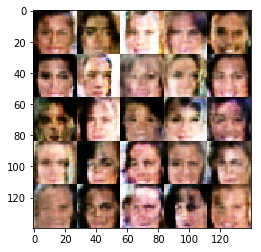

Epoch 1/1 Step 980... Discriminator Loss: 1.2205... Generator Loss: 0.6849


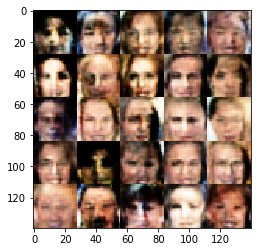

Epoch 1/1 Step 990... Discriminator Loss: 1.0079... Generator Loss: 1.7429


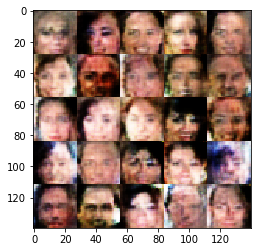

Epoch 1/1 Step 1000... Discriminator Loss: 0.5750... Generator Loss: 2.2769


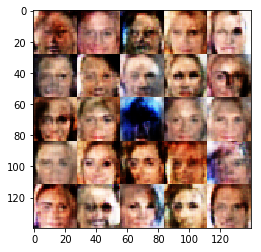

Epoch 1/1 Step 1010... Discriminator Loss: 0.9709... Generator Loss: 0.9592


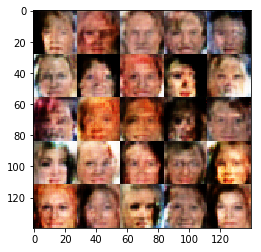

Epoch 1/1 Step 1020... Discriminator Loss: 1.3157... Generator Loss: 2.0148


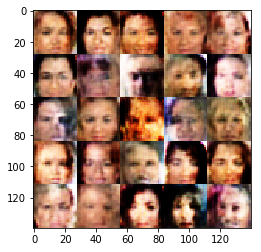

Epoch 1/1 Step 1030... Discriminator Loss: 0.6975... Generator Loss: 2.0588


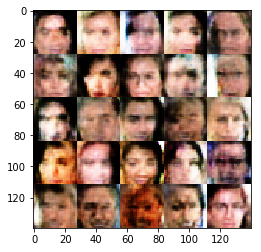

Epoch 1/1 Step 1040... Discriminator Loss: 1.2369... Generator Loss: 2.4991


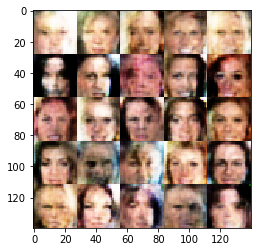

Epoch 1/1 Step 1050... Discriminator Loss: 1.4361... Generator Loss: 0.5092


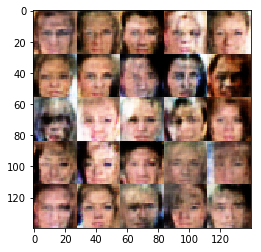

Epoch 1/1 Step 1060... Discriminator Loss: 1.2937... Generator Loss: 0.5872


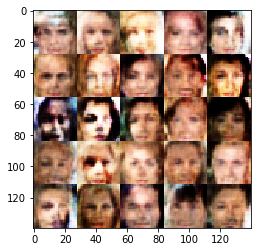

Epoch 1/1 Step 1070... Discriminator Loss: 0.6897... Generator Loss: 1.8449


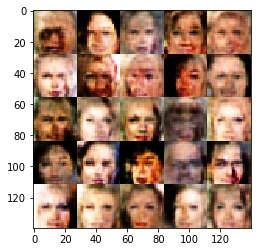

Epoch 1/1 Step 1080... Discriminator Loss: 1.5064... Generator Loss: 2.3134


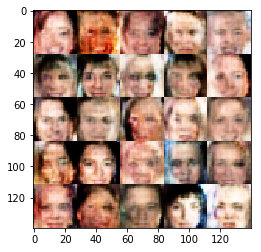

Epoch 1/1 Step 1090... Discriminator Loss: 0.7766... Generator Loss: 1.6046


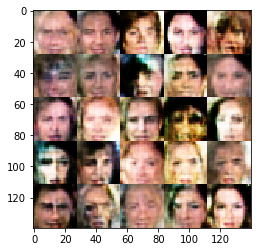

Epoch 1/1 Step 1100... Discriminator Loss: 0.8541... Generator Loss: 1.1360


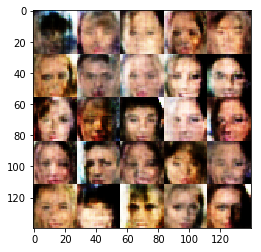

Epoch 1/1 Step 1110... Discriminator Loss: 1.4874... Generator Loss: 2.9122


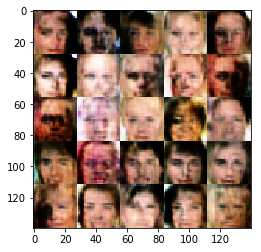

Epoch 1/1 Step 1120... Discriminator Loss: 0.9048... Generator Loss: 0.9746


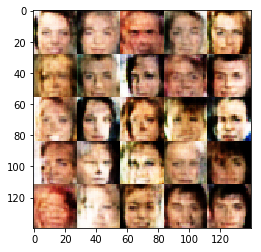

Epoch 1/1 Step 1130... Discriminator Loss: 0.7430... Generator Loss: 2.5944


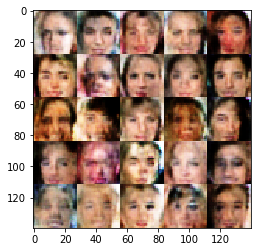

Epoch 1/1 Step 1140... Discriminator Loss: 0.8389... Generator Loss: 1.4174


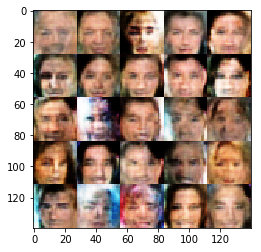

Epoch 1/1 Step 1150... Discriminator Loss: 0.8672... Generator Loss: 1.2356


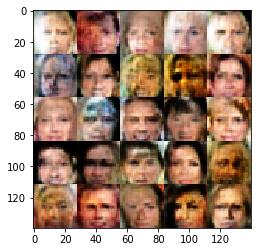

Epoch 1/1 Step 1160... Discriminator Loss: 1.4238... Generator Loss: 0.5301


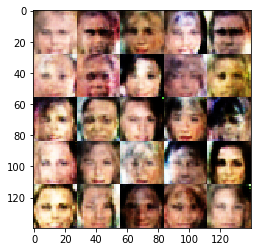

Epoch 1/1 Step 1170... Discriminator Loss: 0.9792... Generator Loss: 1.3315


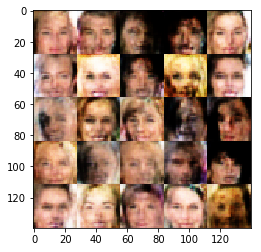

Epoch 1/1 Step 1180... Discriminator Loss: 0.6582... Generator Loss: 2.0691


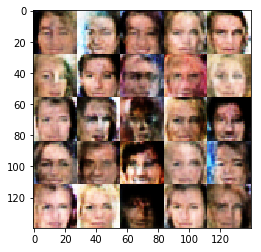

Epoch 1/1 Step 1190... Discriminator Loss: 1.1754... Generator Loss: 0.7003


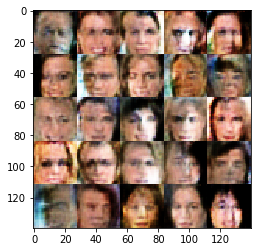

Epoch 1/1 Step 1200... Discriminator Loss: 0.9298... Generator Loss: 1.8042


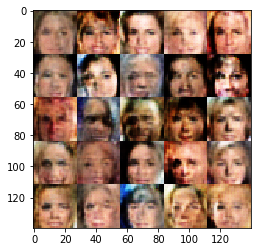

Epoch 1/1 Step 1210... Discriminator Loss: 0.9207... Generator Loss: 2.2787


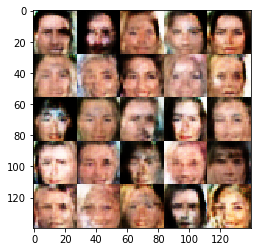

Epoch 1/1 Step 1220... Discriminator Loss: 0.6702... Generator Loss: 2.0868


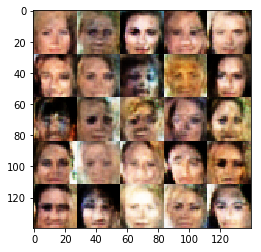

Epoch 1/1 Step 1230... Discriminator Loss: 0.8679... Generator Loss: 1.1492


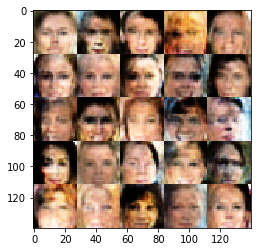

Epoch 1/1 Step 1240... Discriminator Loss: 0.8736... Generator Loss: 1.1377


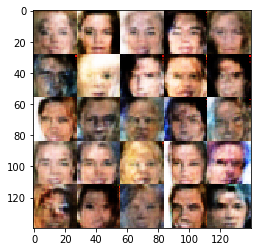

Epoch 1/1 Step 1250... Discriminator Loss: 1.1049... Generator Loss: 2.3545


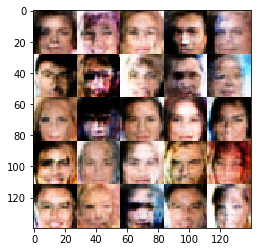

Epoch 1/1 Step 1260... Discriminator Loss: 0.8737... Generator Loss: 1.0578


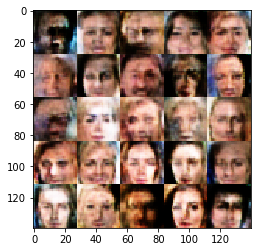

Epoch 1/1 Step 1270... Discriminator Loss: 2.5207... Generator Loss: 2.6817


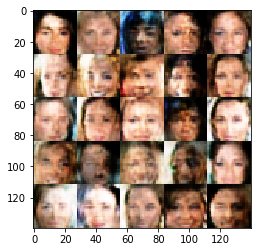

Epoch 1/1 Step 1280... Discriminator Loss: 1.1538... Generator Loss: 0.7844


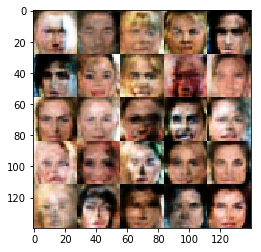

Epoch 1/1 Step 1290... Discriminator Loss: 1.5440... Generator Loss: 0.4654


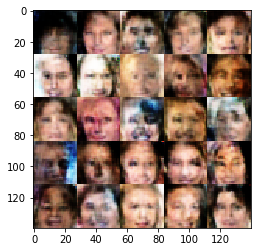

Epoch 1/1 Step 1300... Discriminator Loss: 1.3547... Generator Loss: 0.5909


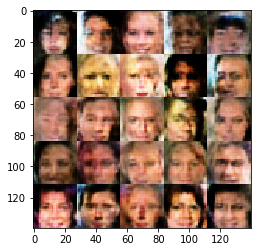

Epoch 1/1 Step 1310... Discriminator Loss: 0.6100... Generator Loss: 2.4001


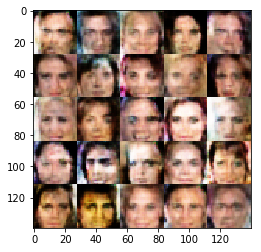

Epoch 1/1 Step 1320... Discriminator Loss: 0.8910... Generator Loss: 1.6205


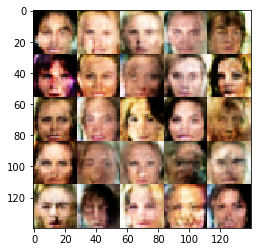

Epoch 1/1 Step 1330... Discriminator Loss: 0.5545... Generator Loss: 2.3675


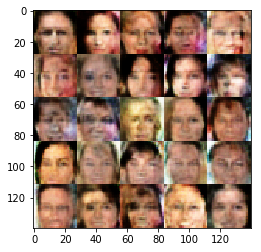

Epoch 1/1 Step 1340... Discriminator Loss: 0.7368... Generator Loss: 1.8452


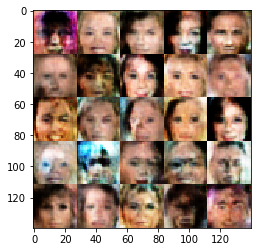

Epoch 1/1 Step 1350... Discriminator Loss: 1.8149... Generator Loss: 0.3552


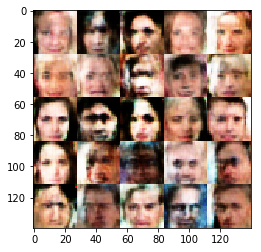

Epoch 1/1 Step 1360... Discriminator Loss: 0.9467... Generator Loss: 1.3863


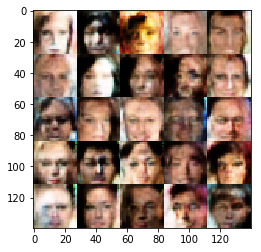

Epoch 1/1 Step 1370... Discriminator Loss: 0.9125... Generator Loss: 0.9744


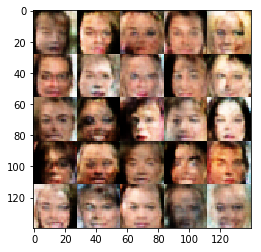

Epoch 1/1 Step 1380... Discriminator Loss: 0.9154... Generator Loss: 1.0525


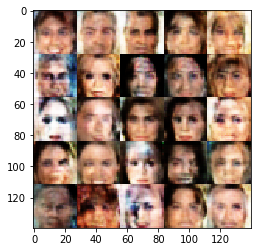

Epoch 1/1 Step 1390... Discriminator Loss: 0.6608... Generator Loss: 2.0817


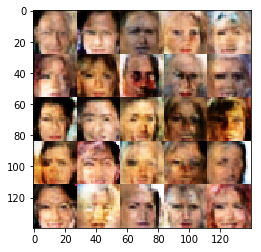

Epoch 1/1 Step 1400... Discriminator Loss: 1.5598... Generator Loss: 0.4318


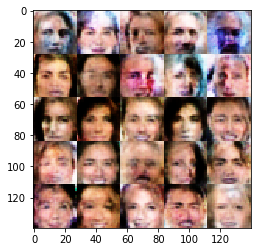

Epoch 1/1 Step 1410... Discriminator Loss: 1.0298... Generator Loss: 0.8719


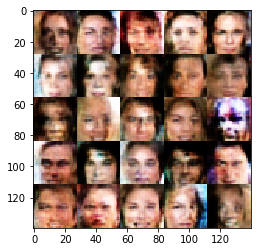

Epoch 1/1 Step 1420... Discriminator Loss: 0.9060... Generator Loss: 2.6196


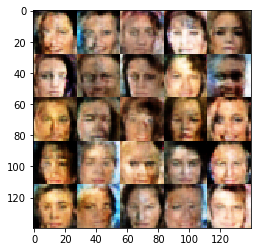

Epoch 1/1 Step 1430... Discriminator Loss: 0.5813... Generator Loss: 2.5208


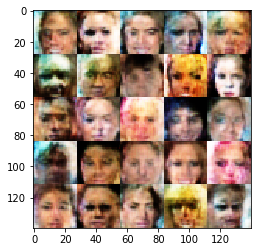

Epoch 1/1 Step 1440... Discriminator Loss: 0.5509... Generator Loss: 3.5074


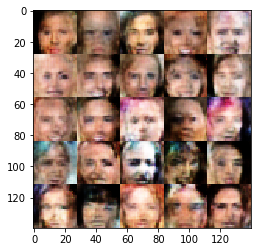

Epoch 1/1 Step 1450... Discriminator Loss: 0.6026... Generator Loss: 2.3458


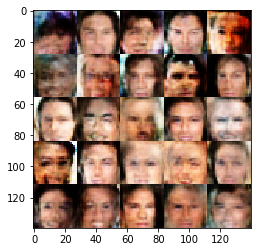

Epoch 1/1 Step 1460... Discriminator Loss: 0.6166... Generator Loss: 2.5253


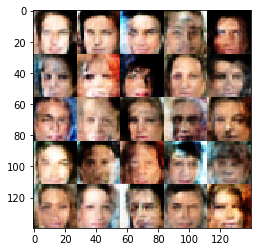

Epoch 1/1 Step 1470... Discriminator Loss: 1.5271... Generator Loss: 0.4783


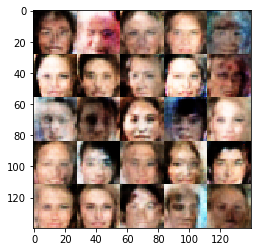

Epoch 1/1 Step 1480... Discriminator Loss: 1.0355... Generator Loss: 2.3118


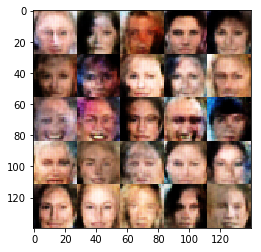

Epoch 1/1 Step 1490... Discriminator Loss: 1.1945... Generator Loss: 0.7141


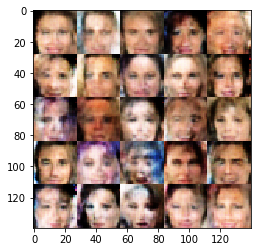

Epoch 1/1 Step 1500... Discriminator Loss: 1.0160... Generator Loss: 1.3243


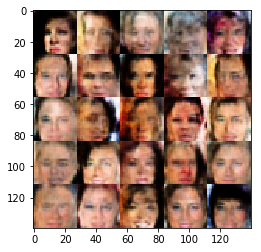

Epoch 1/1 Step 1510... Discriminator Loss: 0.9321... Generator Loss: 1.0400


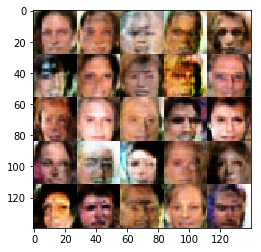

Epoch 1/1 Step 1520... Discriminator Loss: 0.6472... Generator Loss: 3.5019


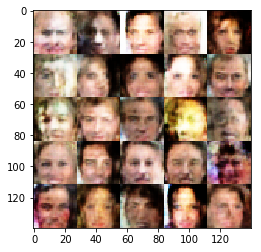

Epoch 1/1 Step 1530... Discriminator Loss: 1.0438... Generator Loss: 2.4144


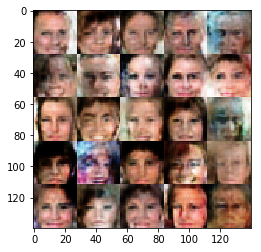

Epoch 1/1 Step 1540... Discriminator Loss: 0.6579... Generator Loss: 2.1385


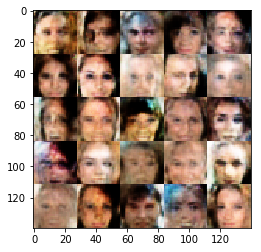

Epoch 1/1 Step 1550... Discriminator Loss: 1.0368... Generator Loss: 2.5397


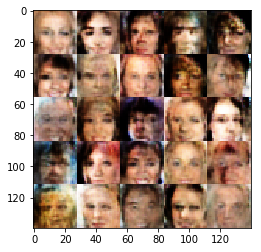

Epoch 1/1 Step 1560... Discriminator Loss: 1.2672... Generator Loss: 3.2163


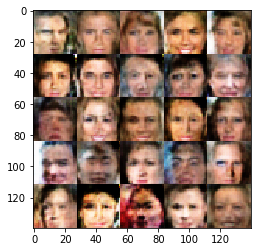

Epoch 1/1 Step 1570... Discriminator Loss: 0.6720... Generator Loss: 2.3260


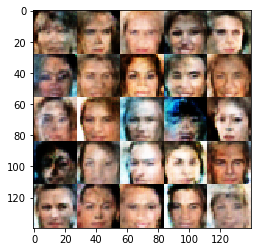

Epoch 1/1 Step 1580... Discriminator Loss: 1.1175... Generator Loss: 1.7480


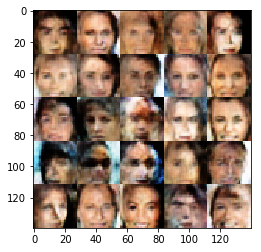

Epoch 1/1 Step 1590... Discriminator Loss: 1.0863... Generator Loss: 0.8670


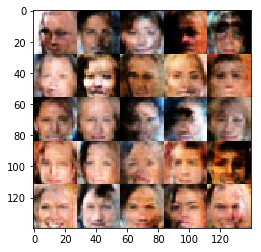

Epoch 1/1 Step 1600... Discriminator Loss: 0.7187... Generator Loss: 2.0223


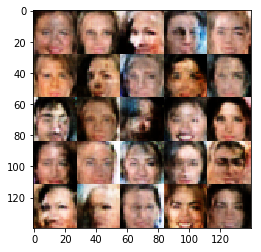

Epoch 1/1 Step 1610... Discriminator Loss: 0.7807... Generator Loss: 1.2717


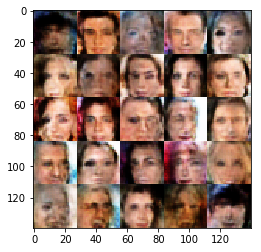

Epoch 1/1 Step 1620... Discriminator Loss: 0.9942... Generator Loss: 0.9817


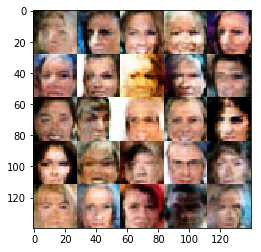

Epoch 1/1 Step 1630... Discriminator Loss: 2.3093... Generator Loss: 0.2638


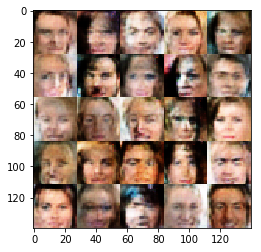

Epoch 1/1 Step 1640... Discriminator Loss: 0.8892... Generator Loss: 1.8993


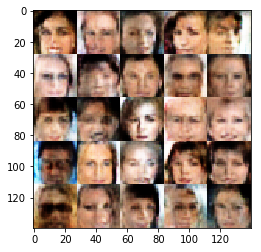

Epoch 1/1 Step 1650... Discriminator Loss: 1.2781... Generator Loss: 2.9494


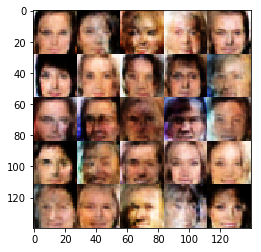

Epoch 1/1 Step 1660... Discriminator Loss: 0.7163... Generator Loss: 1.3283


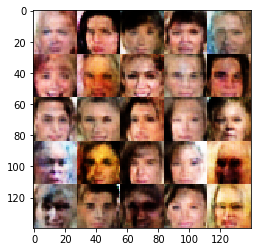

Epoch 1/1 Step 1670... Discriminator Loss: 0.6817... Generator Loss: 2.3066


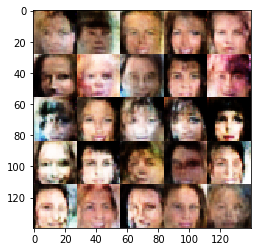

Epoch 1/1 Step 1680... Discriminator Loss: 0.4798... Generator Loss: 3.0765


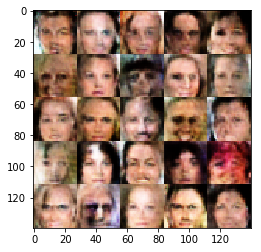

Epoch 1/1 Step 1690... Discriminator Loss: 0.8843... Generator Loss: 1.6644


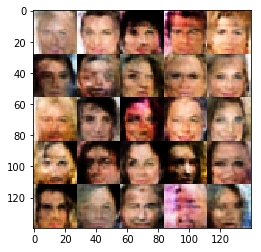

Epoch 1/1 Step 1700... Discriminator Loss: 1.5822... Generator Loss: 0.4775


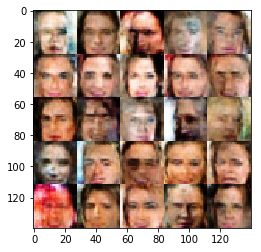

Epoch 1/1 Step 1710... Discriminator Loss: 0.9793... Generator Loss: 3.1678


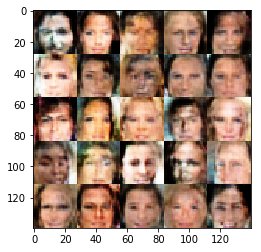

Epoch 1/1 Step 1720... Discriminator Loss: 0.8928... Generator Loss: 1.0619


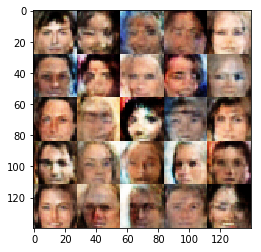

Epoch 1/1 Step 1730... Discriminator Loss: 0.7811... Generator Loss: 1.6186


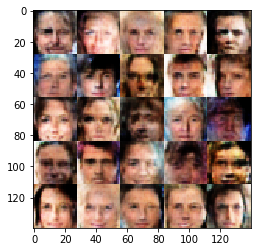

Epoch 1/1 Step 1740... Discriminator Loss: 0.6816... Generator Loss: 1.7363


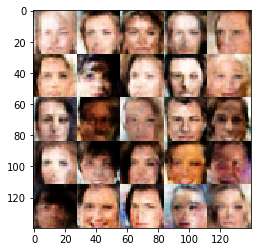

Epoch 1/1 Step 1750... Discriminator Loss: 0.6625... Generator Loss: 2.4025


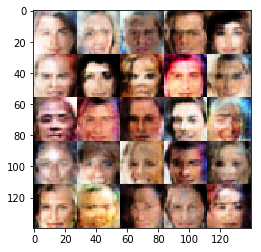

Epoch 1/1 Step 1760... Discriminator Loss: 0.8413... Generator Loss: 2.4573


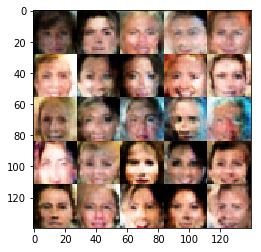

Epoch 1/1 Step 1770... Discriminator Loss: 0.9105... Generator Loss: 1.0223


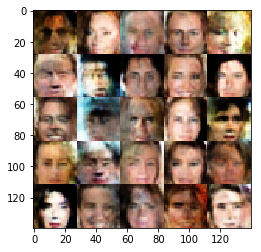

Epoch 1/1 Step 1780... Discriminator Loss: 0.4765... Generator Loss: 3.0522


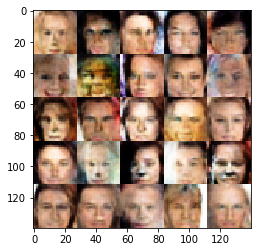

Epoch 1/1 Step 1790... Discriminator Loss: 0.7783... Generator Loss: 4.1307


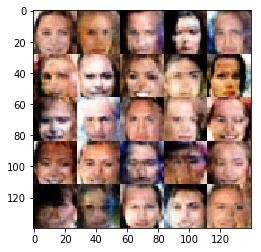

Epoch 1/1 Step 1800... Discriminator Loss: 0.5467... Generator Loss: 2.3312


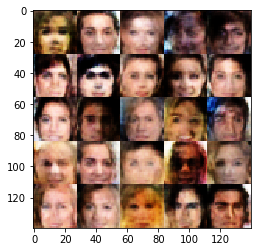

Epoch 1/1 Step 1810... Discriminator Loss: 0.8156... Generator Loss: 1.2552


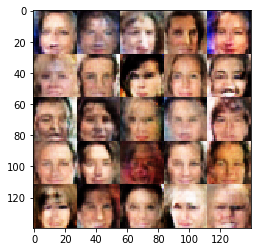

Epoch 1/1 Step 1820... Discriminator Loss: 1.1201... Generator Loss: 0.7206


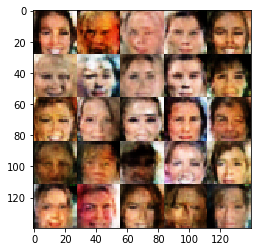

Epoch 1/1 Step 1830... Discriminator Loss: 0.8011... Generator Loss: 1.2555


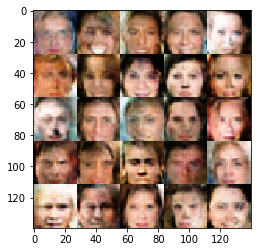

Epoch 1/1 Step 1840... Discriminator Loss: 0.9337... Generator Loss: 2.1984


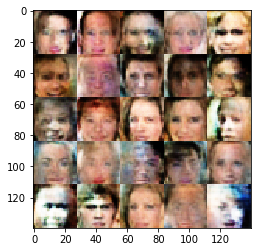

Epoch 1/1 Step 1850... Discriminator Loss: 0.9094... Generator Loss: 1.6737


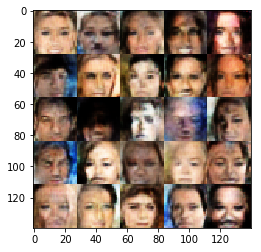

Epoch 1/1 Step 1860... Discriminator Loss: 1.0459... Generator Loss: 0.8318


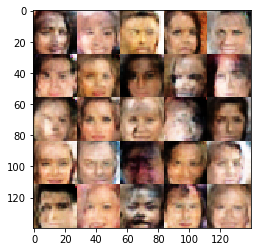

Epoch 1/1 Step 1870... Discriminator Loss: 1.3875... Generator Loss: 1.8137


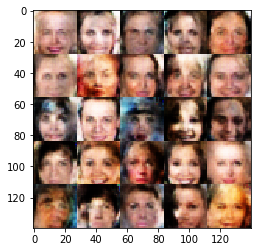

Epoch 1/1 Step 1880... Discriminator Loss: 0.8131... Generator Loss: 1.2761


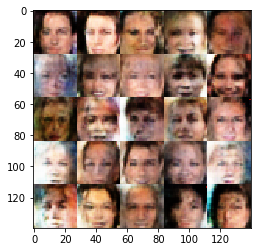

Epoch 1/1 Step 1890... Discriminator Loss: 0.5548... Generator Loss: 2.1789


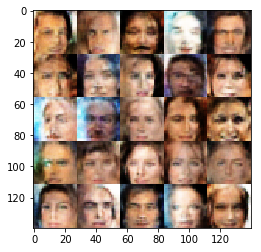

Epoch 1/1 Step 1900... Discriminator Loss: 0.5743... Generator Loss: 2.6945


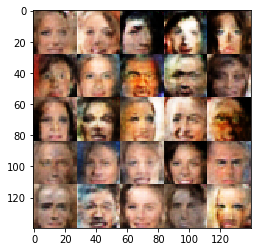

Epoch 1/1 Step 1910... Discriminator Loss: 0.5519... Generator Loss: 3.5334


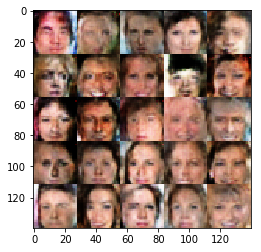

Epoch 1/1 Step 1920... Discriminator Loss: 0.5416... Generator Loss: 2.1047


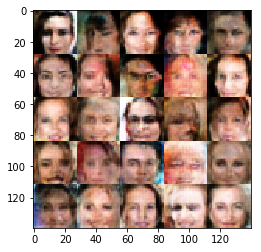

Epoch 1/1 Step 1930... Discriminator Loss: 1.6584... Generator Loss: 0.4358


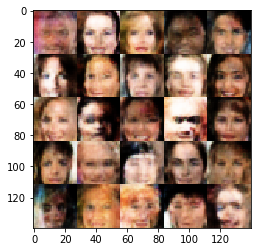

Epoch 1/1 Step 1940... Discriminator Loss: 0.8329... Generator Loss: 1.4907


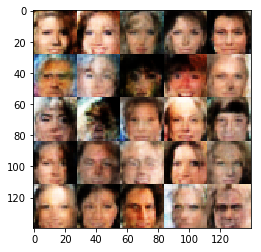

Epoch 1/1 Step 1950... Discriminator Loss: 1.3835... Generator Loss: 2.9829


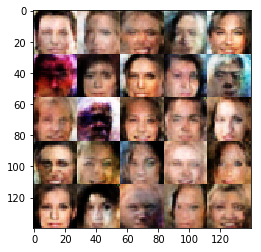

Epoch 1/1 Step 1960... Discriminator Loss: 0.7094... Generator Loss: 2.5331


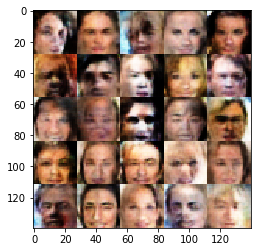

Epoch 1/1 Step 1970... Discriminator Loss: 0.5221... Generator Loss: 2.2456


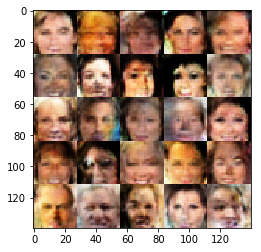

Epoch 1/1 Step 1980... Discriminator Loss: 0.6276... Generator Loss: 1.8743


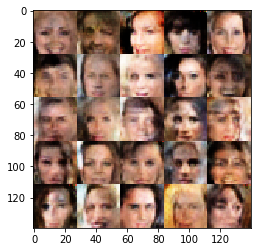

Epoch 1/1 Step 1990... Discriminator Loss: 0.4719... Generator Loss: 2.7153


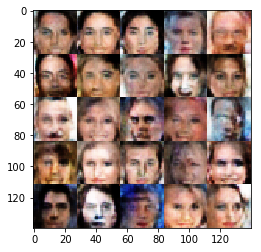

Epoch 1/1 Step 2000... Discriminator Loss: 0.5260... Generator Loss: 2.7526


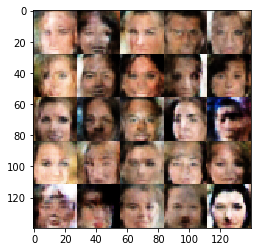

Epoch 1/1 Step 2010... Discriminator Loss: 0.6829... Generator Loss: 1.6492


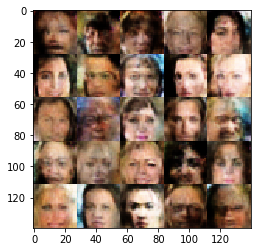

Epoch 1/1 Step 2020... Discriminator Loss: 0.8088... Generator Loss: 2.7573


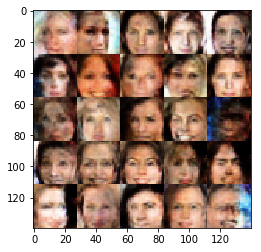

In [49]:
batch_size = 100
z_dim = 100
learning_rate = 0.001
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.